# Automatas 1D

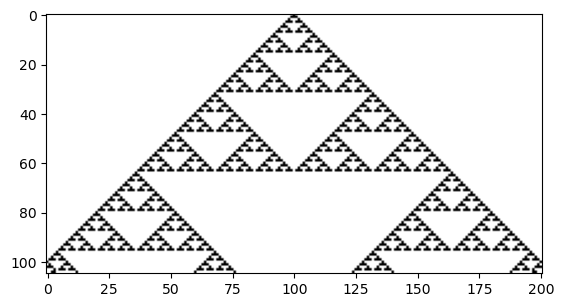

In [2]:
# REGLA C
import numpy as np
import matplotlib.pyplot as plt

# variables
N = 201
tmax = round(N/2) + 5

# Grilla
grid = np.zeros((tmax, N))
grid[0, round(N/2)] = 1     # condiciones iniciales (fila 0)
#grid[0] = np.random.randint(0, 2, size=N)   # condiciones iniciales aleatorias

# Evolucionar la grilla
for fila in range(1, tmax):
    for col in range(N):
        # vecindario
        vecino_izq = grid[fila - 1, col - 1]
        vecino_cen = grid[fila - 1, col]
        vecino_der = grid[fila - 1, (col + 1)%N]
        
        # Regla C, solo un vecino activo
        grid[fila, col] = (
            (vecino_izq and not vecino_cen and not vecino_der) or
            (not vecino_izq and vecino_cen and not vecino_der) or
            (not vecino_izq and not vecino_cen and vecino_der)
        )

# Graficar
plt.imshow(grid, cmap= "binary")

# Autómatas 2D

In [2]:
import numpy as np 
import matplotlib.pyplot as plt

## Regla

Un nodo se pone negro (activo) si uno y sólo uno de
sus vecinos está activo. Una vez activo (negro), se queda así. 

(-0.5, 100.5, 100.5, -0.5)

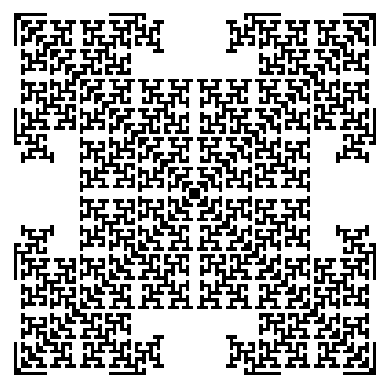

In [10]:
N = 101
tmax = 55

grid = np.zeros((N, N))

# Initial Conditions
grid[int(N/2), int(N/2)] = 1

# Evolution
for _ in range(tmax):
    grid_before = np.copy(grid)
    for row in range(1, N-1):
        for col in range(1, N-1):
            vecindario = grid_before[row-1:row+2, col-1:col+2]
            grid[row, col] = (vecindario.sum() == 1) or (grid_before[row, col])

plt.imshow(grid, cmap="binary")
plt.axis("off")

## Animación 

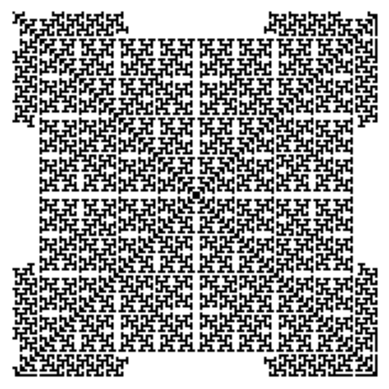

In [9]:
from time import sleep
from matplotlib import animation
from IPython.display import HTML


# Variables
N = 150
tmax = 100
grid = np.zeros((N, N))         # Grilla
grid[int(N/2), int(N/2)] = 1    # Initial Conditions

# Figura y Axe
fig, ax = plt.subplots()
im = ax.imshow(grid, cmap="binary")
ax.set_axis_off()

# init
def init():
    im.set_data(grid)
    return (im,)

# update
def update(i):
    grid_before = np.copy(grid)
    for row in range(1, N-1):
        for col in range(1, N-1):
            vecindario = grid_before[row-1:row+2, col-1:col+2]
            grid[row, col] = (vecindario.sum() == 1) or (grid_before[row, col])
    im.set_data(grid)

    return (im,)

anim = animation.FuncAnimation(fig, func=update, init_func=init, frames=tmax, interval=150)
HTML(anim.to_jshtml())


## EL Juego de la Vida de Conway

1. Si un nodo activo tiene menos de dos vecinos activos, se inactiva.
2. Si un nodo activo tiene más de tres vecinos activos, se inactiva.
3. Si un nodo inactivo tiene tres vecinos activos, se activa.
4. Si un nodo tiene dos vecinos activos, se queda igual.

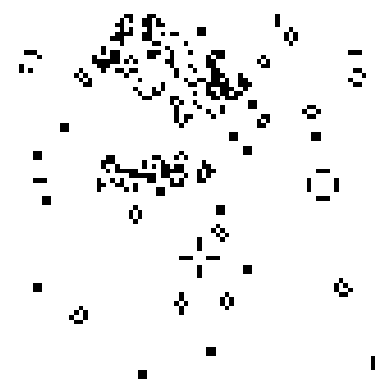

In [55]:
import numpy as np
from time import sleep
from matplotlib import animation
from IPython.display import HTML


# Variables
N = 81
tmax = 600
grid = np.zeros((N, N))         # Grilla
grid[int(N/2), int(N/2)] = 1    # Initial Conditions
grid = np.random.randint(0, 2, (N, N))

# Figura y Axe
fig, ax = plt.subplots()
im = ax.imshow(grid, cmap="binary")
ax.set_axis_off()

# init
def init():
    im.set_data(grid)
    return (im,)

# update
def update(i):
    grid_before = np.copy(grid)
    for row in range(N):
        for col in range(N):
            vecindario = grid_before[row-1:row+2, col-1:col+2]
            suma = vecindario.sum() - grid_before[row, col]
            if suma == 2:
                continue
            if suma == 3:
                grid[row, col] = 1
                continue
            if (suma > 3) or (suma < 2):
                grid[row, col] = 0
                continue
    im.set_data(grid)

    return (im,)

anim = animation.FuncAnimation(fig, func=update, init_func=init, frames=tmax, interval=30)
HTML(anim.to_jshtml())


(-0.5, 20.5, 20.5, -0.5)

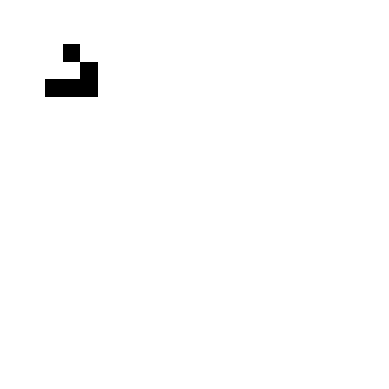

In [49]:
# Variables
N = 21
tmax = 60
grid = np.zeros((N, N))         # Grilla

# Glider
s = 2
grid[ 0+s, 1+s] = 1
grid[1+s, 2+s] = 1
grid[ 2+s, 0+s:3+s] = 1

plt.imshow(grid, cmap="binary")
plt.axis("off")

### Glider

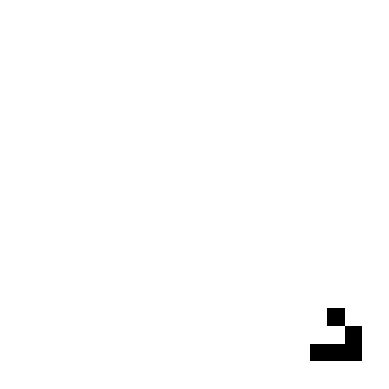

In [50]:
import numpy as np
from time import sleep
from matplotlib import animation
from IPython.display import HTML


# Variables
N = 21
tmax = 60
grid = np.zeros((N, N))         # Grilla

# Glider
s = 2
grid[ 0+s, 1+s] = 1
grid[1+s, 2+s] = 1
grid[ 2+s, 0+s:3+s] = 1

# Figura y Axe
fig, ax = plt.subplots()
im = ax.imshow(grid, cmap="binary")
ax.set_axis_off()

# init
def init():
    im.set_data(grid)
    return (im,)

# update
def update(i):
    grid_before = np.copy(grid)
    for row in range(N):
        for col in range(N):
            vecindario = grid_before[row-1:row+2, col-1:col+2]
            suma = vecindario.sum() - grid_before[row, col]
            if suma == 2:
                continue
            if suma == 3:
                grid[row, col] = 1
                continue
            if (suma > 3) or (suma < 2):
                grid[row, col] = 0
                continue
    im.set_data(grid)

    return (im,)

anim = animation.FuncAnimation(fig, func=update, init_func=init, frames=tmax, interval=30)
HTML(anim.to_jshtml())


(-0.5, 20.5, 20.5, -0.5)

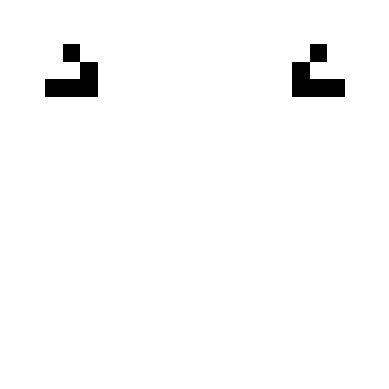

In [51]:
# Variables
N = 21
tmax = 60
grid = np.zeros((N, N))         # Grilla

# Glider
s = 2
grid[ 0+s, 1+s] = 1
grid[1+s, 2+s] = 1
grid[ 2+s, 0+s:3+s] = 1

# Glider 2
s = 2
grid[ 0+s, N -2 -s] = 1
grid[1+s, N - 3 -s] = 1
grid[ 2+s, N - 3 - s : N -s] = 1


plt.imshow(grid, cmap="binary")
plt.axis("off")

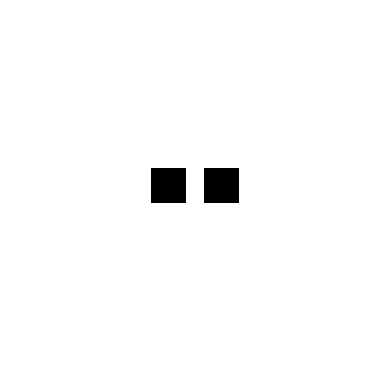

In [54]:
import numpy as np
from time import sleep
from matplotlib import animation
from IPython.display import HTML


# Variables
N = 21
tmax = 30
grid = np.zeros((N, N))         # Grilla

# Glider 1
s = 2   # offset
grid[ 0+s, 1+s] = 1
grid[1+s, 2+s] = 1
grid[ 2+s, 0+s:3+s] = 1

# Glider 2
grid[ 0+s, N -2 -s] = 1
grid[1+s, N - 3 -s] = 1
grid[ 2+s, N - 3 - s : N -s] = 1

# Figura y Axe
fig, ax = plt.subplots()
im = ax.imshow(grid, cmap="binary")
ax.set_axis_off()
# init
def init():
    im.set_data(grid)
    return (im,)

# update
def update(i):
    grid_before = np.copy(grid)
    for row in range(N):
        for col in range(N):
            vecindario = grid_before[row-1:row+2, col-1:col+2]
            suma = vecindario.sum() - grid_before[row, col]
            if suma == 2:
                continue
            if suma == 3:
                grid[row, col] = 1
                continue
            if (suma > 3) or (suma < 2):
                grid[row, col] = 0
                continue
    im.set_data(grid)

    return (im,)

anim = animation.FuncAnimation(fig, func=update, init_func=init, frames=tmax, interval=30)
HTML(anim.to_jshtml())


## Crecimiento infinito

(-0.5, 99.5, 99.5, -0.5)

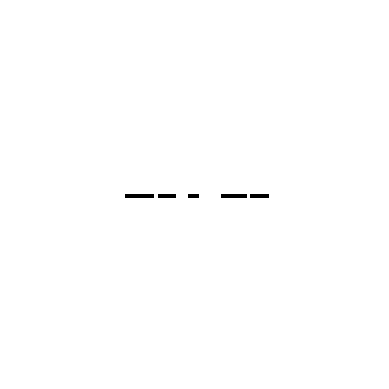

In [63]:
# Variables
N = 100
tmax = 60
grid = np.zeros((N, N))         # Grilla

# Crecimiento Infinito
fila = int(N/2)
col = int(N/2) - 20
grid[fila, col+1:col+9] = 1
grid[fila, col+10:col+15] = 1
grid[fila, col+18:col+21] = 1
grid[fila, col+27:col+34] = 1
grid[fila, col+35:col+40] = 1



plt.imshow(grid, cmap="binary")
plt.axis("off")

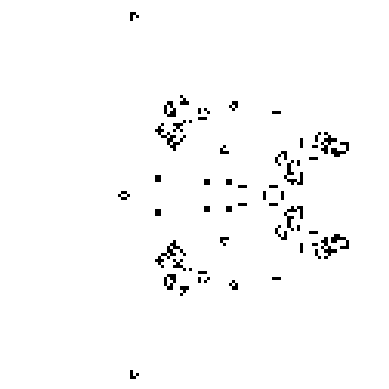

In [62]:
import numpy as np
from time import sleep
from matplotlib import animation
from IPython.display import HTML


# Variables
N = 120
tmax = 300
grid = np.zeros((N, N))         # Grilla

# Small
fila = int(N/2)
col = int(N/2) - 20
grid[fila, col+1:col+9] = 1
grid[fila, col+10:col+15] = 1
grid[fila, col+18:col+21] = 1
grid[fila, col+27:col+34] = 1
grid[fila, col+35:col+40] = 1

# Figura y Axe
fig, ax = plt.subplots()
im = ax.imshow(grid, cmap="binary")
ax.set_axis_off()
# init
def init():
    im.set_data(grid)
    return (im,)

# update
def update(i):
    grid_before = np.copy(grid)
    for row in range(N):
        for col in range(N):
            vecindario = grid_before[row-1:row+2, col-1:col+2]
            suma = vecindario.sum() - grid_before[row, col]
            if suma == 2:
                continue
            if suma == 3:
                grid[row, col] = 1
                continue
            if (suma > 3) or (suma < 2):
                grid[row, col] = 0
                continue
    im.set_data(grid)

    return (im,)

anim = animation.FuncAnimation(fig, func=update, init_func=init, frames=tmax, interval=30)
HTML(anim.to_jshtml())
